# How to Train YOLO11 Object Detection Model on a Custom Dataset

Data: https://universe.roboflow.com/project-uyrxf/ppe_detection-v1x3l/dataset/1#

## Step # 01 Install the Ultralytics Package
## Step # 02 Import All the Requried Libraries
## Step # 03 Download Dataset from Roboflow
## Step # 04 Train YOLO11 Model on a Custom Dataset
## Step # 05 Examine Training Results
## Step # 07 Validate Fine-Tuned Model
## Step # 08 Inference with Custom Model on Images
## Step # 09 Inference with Custom Model on Videos

In [4]:
!nvidia-smi

Sun Jan 12 08:17:15 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [5]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 906.8/906.8 kB 24.5 MB/s eta 0:00:00


### Step # 01 Install the Ultralytics Package

In [6]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.5/112.6 GB disk)


In [7]:
from ultralytics import YOLO
from IPython.display import display, Image

### Step # 03 Download Dataset from Roboflow

In [8]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="mKLo8Jlj6hy8KqEpN3qg")
project = rf.workspace("project-uyrxf").project("ppe_detection-v1x3l")
version = project.version(1)
dataset = version.download("yolov8")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.5/81.5 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.8 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to PPE_Detection-1 in yolov8:: 100%|██████████| 6560/6560 [00:01<00:00, 4108.72it/s]


### Step # 04 Train YOLO11 Model on a Custom Dataset


### Step # 05 Examine Training Results

In [9]:
dataset.location

'/content/PPE_Detection-1'

In [10]:
!yolo task=detect mode=train data=/content/PPE_Detection-1/data.yaml model=yolov8n.pt epochs=5 imgsz=640 name=custom_yolo11n

100% 6.25M/6.25M [00:00<00:00, 76.8MB/s]
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/PPE_Detection-1/data.yaml, epochs=5, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=custom_yolo11n, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save

# Step # 05 Examine Training Results

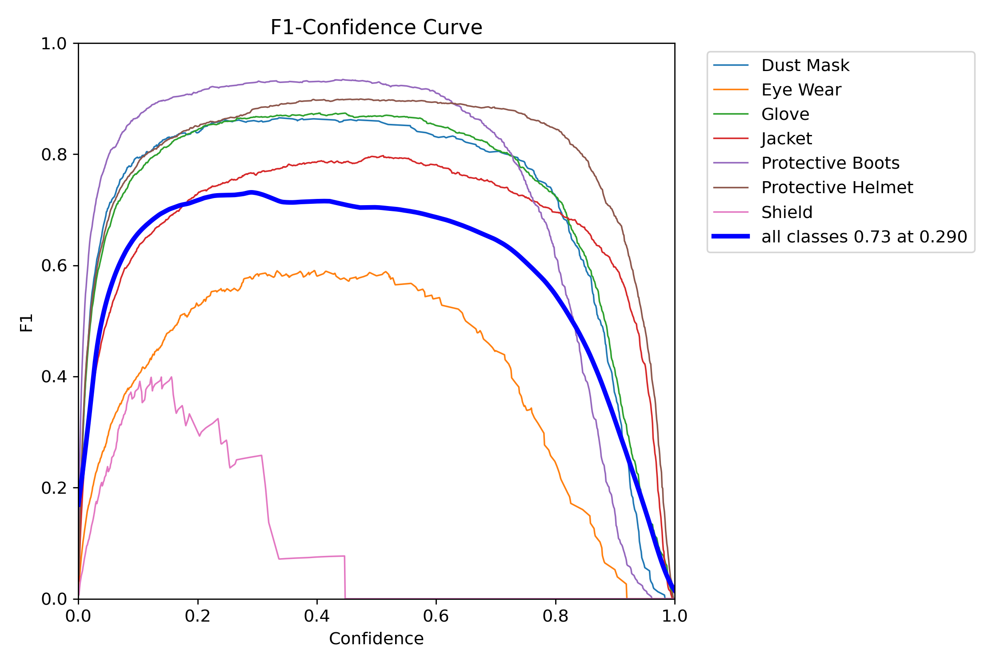

In [22]:

Image("/content/runs/detect/custom_yolo11n/F1_curve.png", width=600)

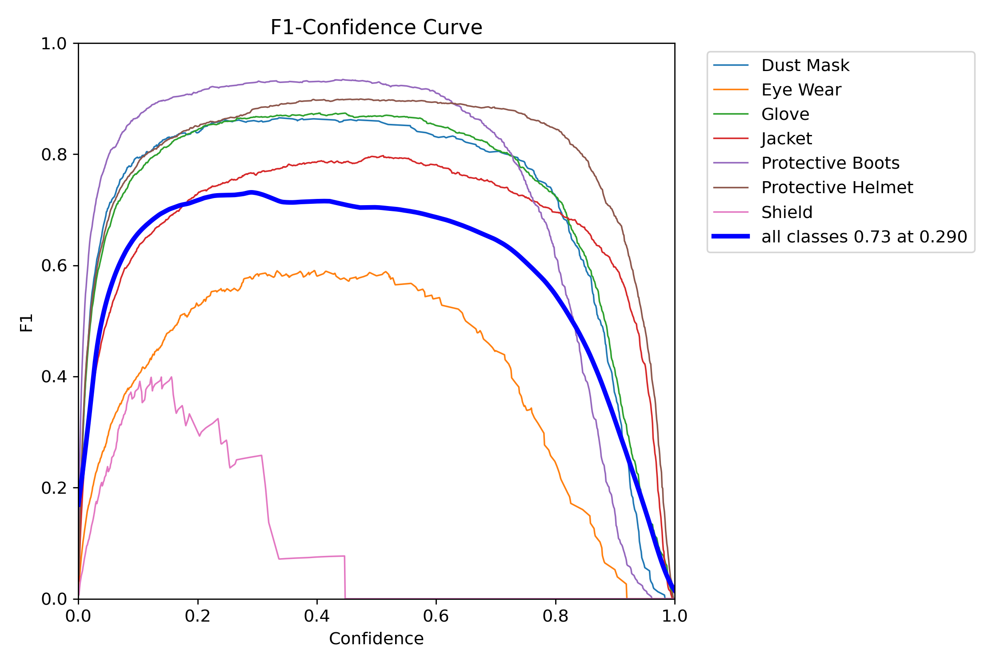

In [23]:
Image("/content/runs/detect/custom_yolo11n/F1_curve.png", width=600)

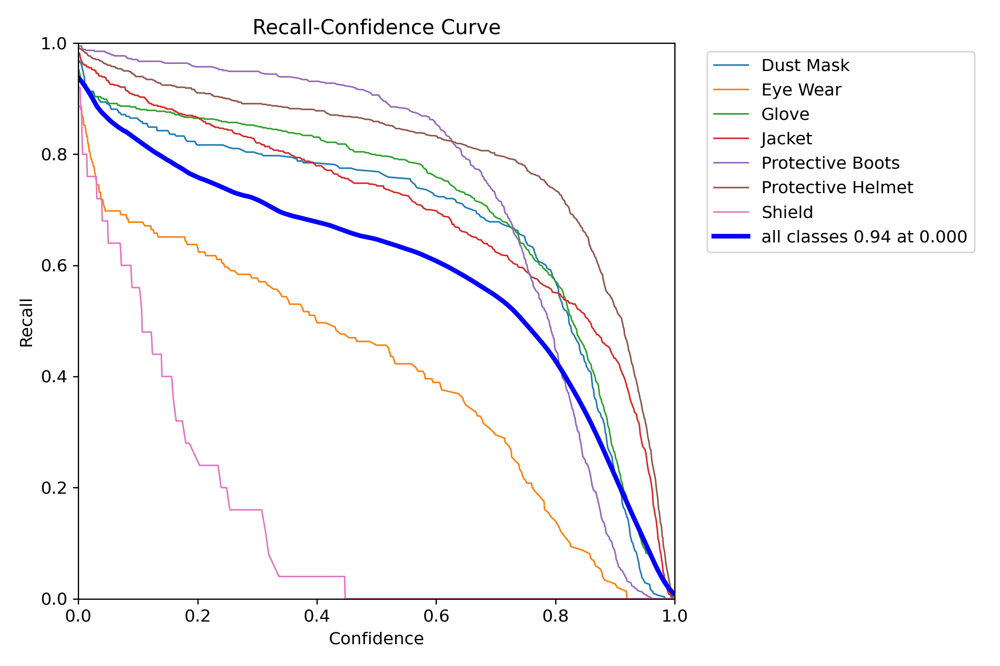

In [24]:
Image("/content/runs/detect/custom_yolo11n/R_curve.png", width=600)

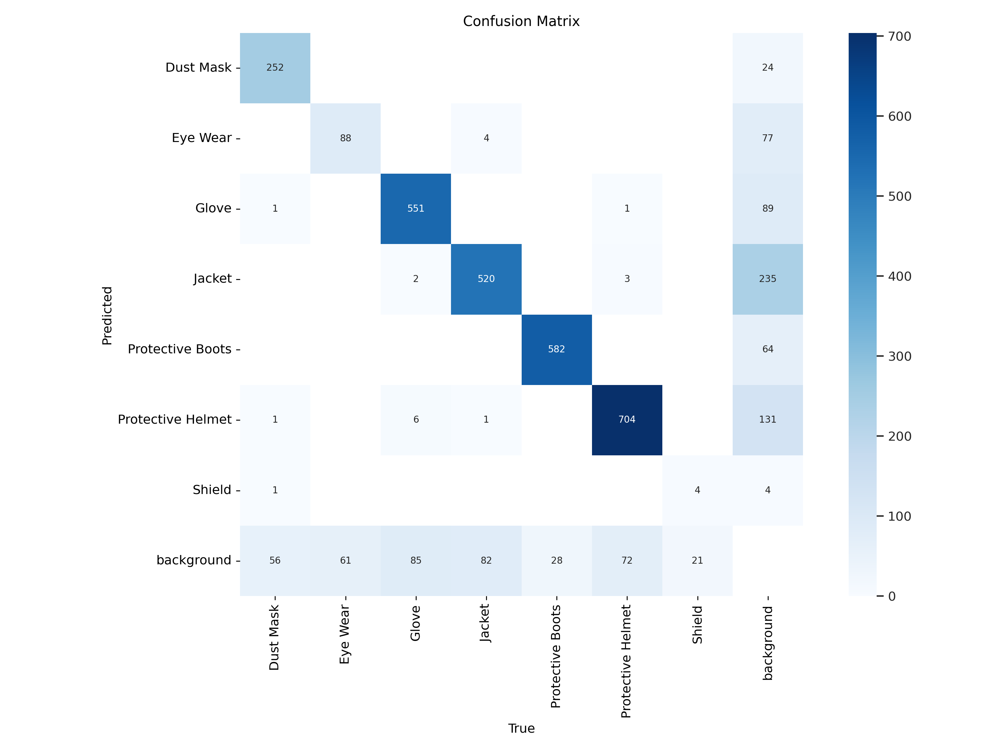

In [25]:
Image("/content/runs/detect/custom_yolo11n/confusion_matrix.png", width=600)

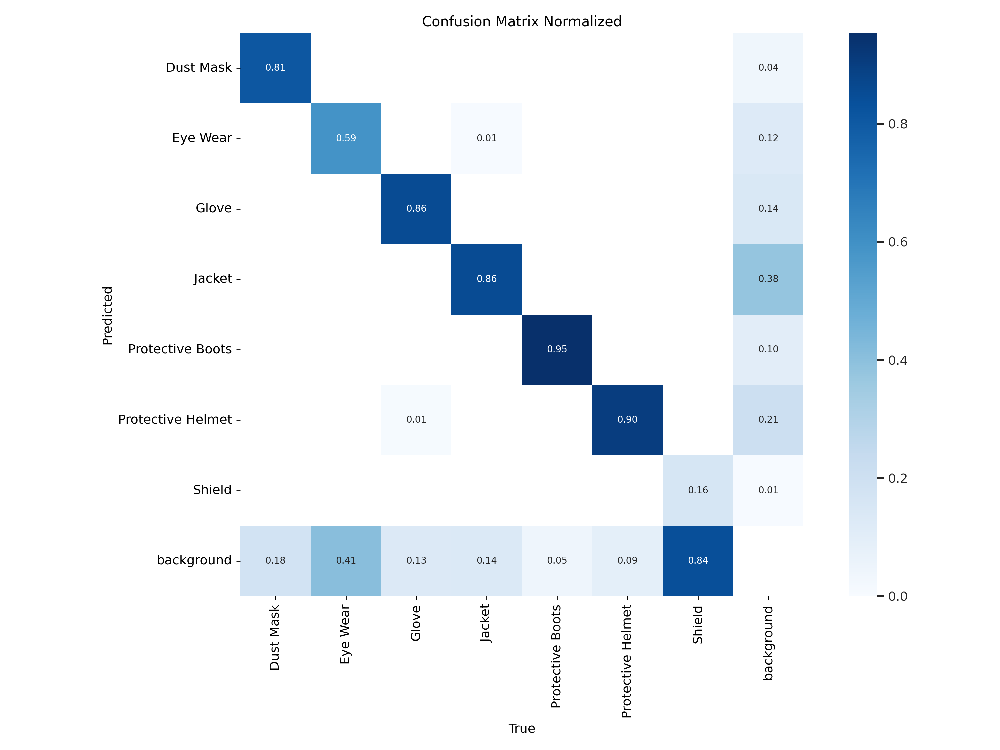

In [26]:
Image("/content/runs/detect/custom_yolo11n/confusion_matrix_normalized.png", width=600)

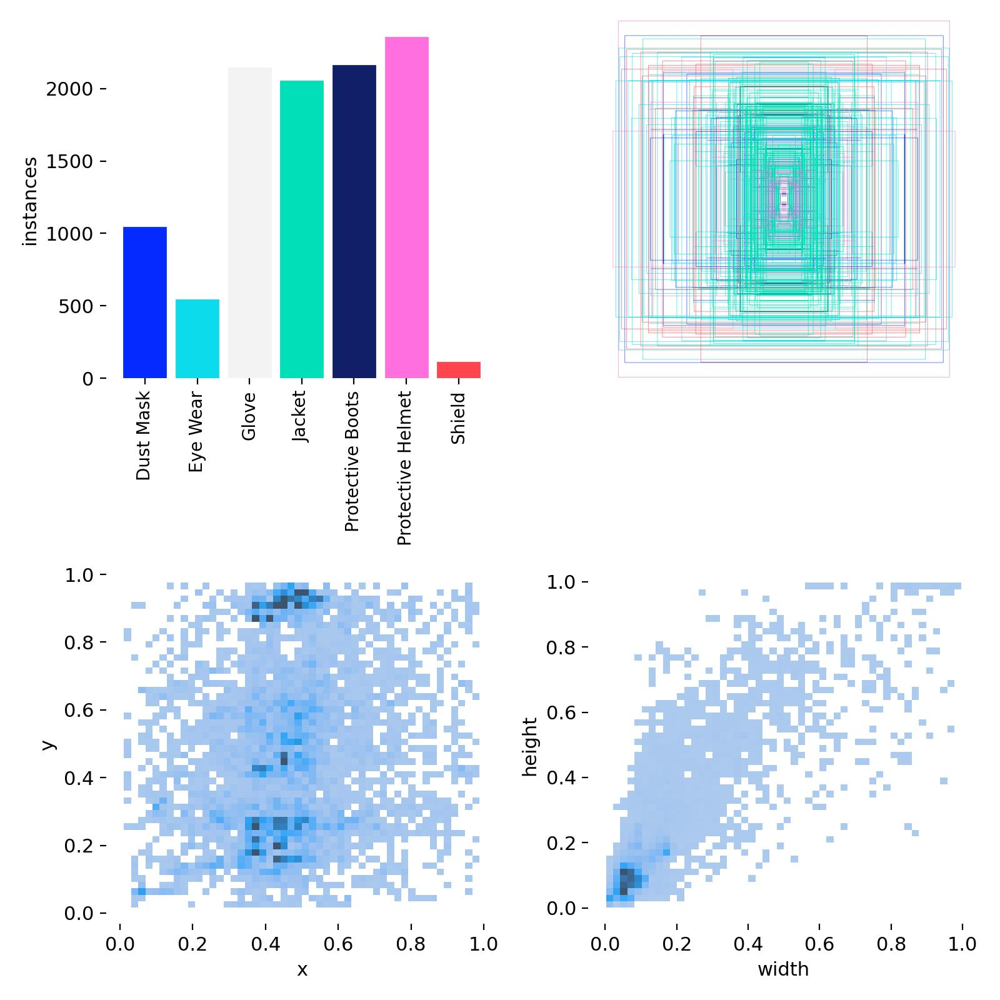

In [27]:
Image("/content/runs/detect/custom_yolo11n/labels.jpg", width=600)

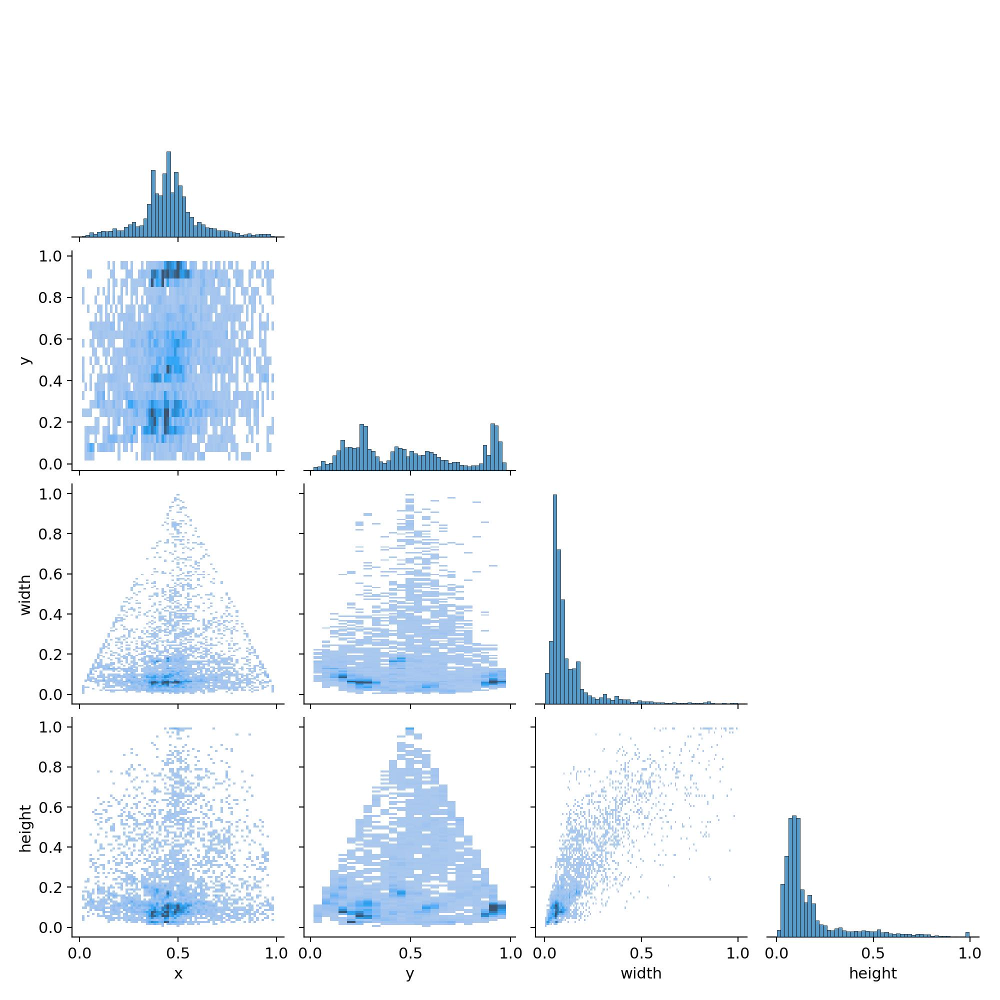

In [28]:
Image("/content/runs/detect/custom_yolo11n/labels_correlogram.jpg", width=600)

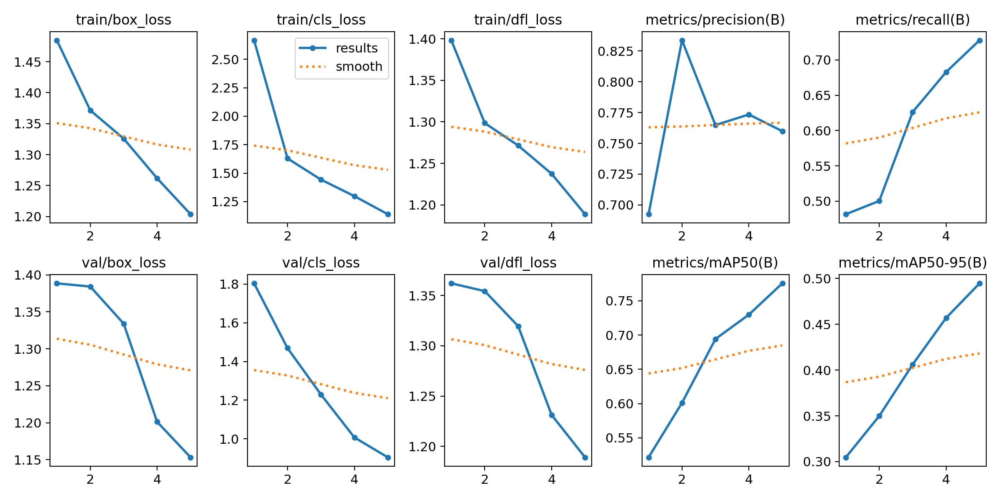

In [29]:
Image("/content/runs/detect/custom_yolo11n/results.png", width=600)

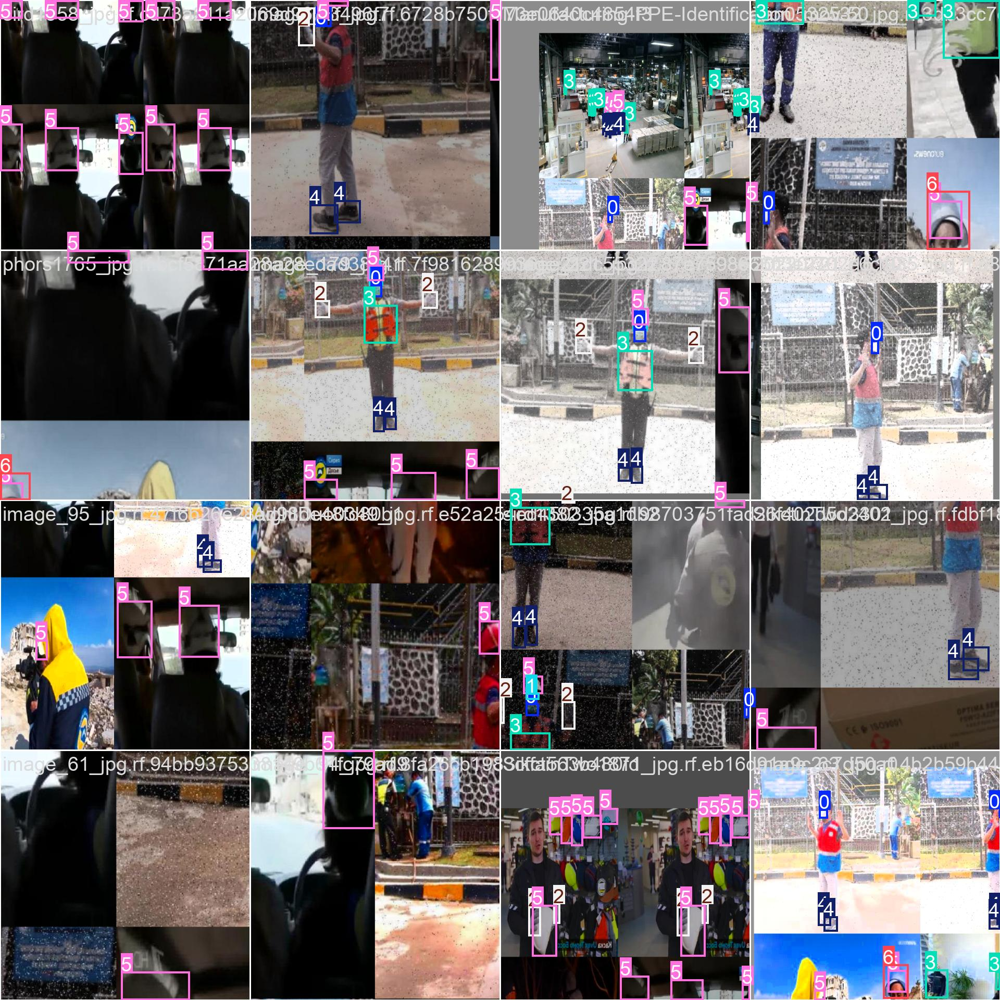

In [30]:
Image("/content/runs/detect/custom_yolo11n/train_batch0.jpg", width=600)

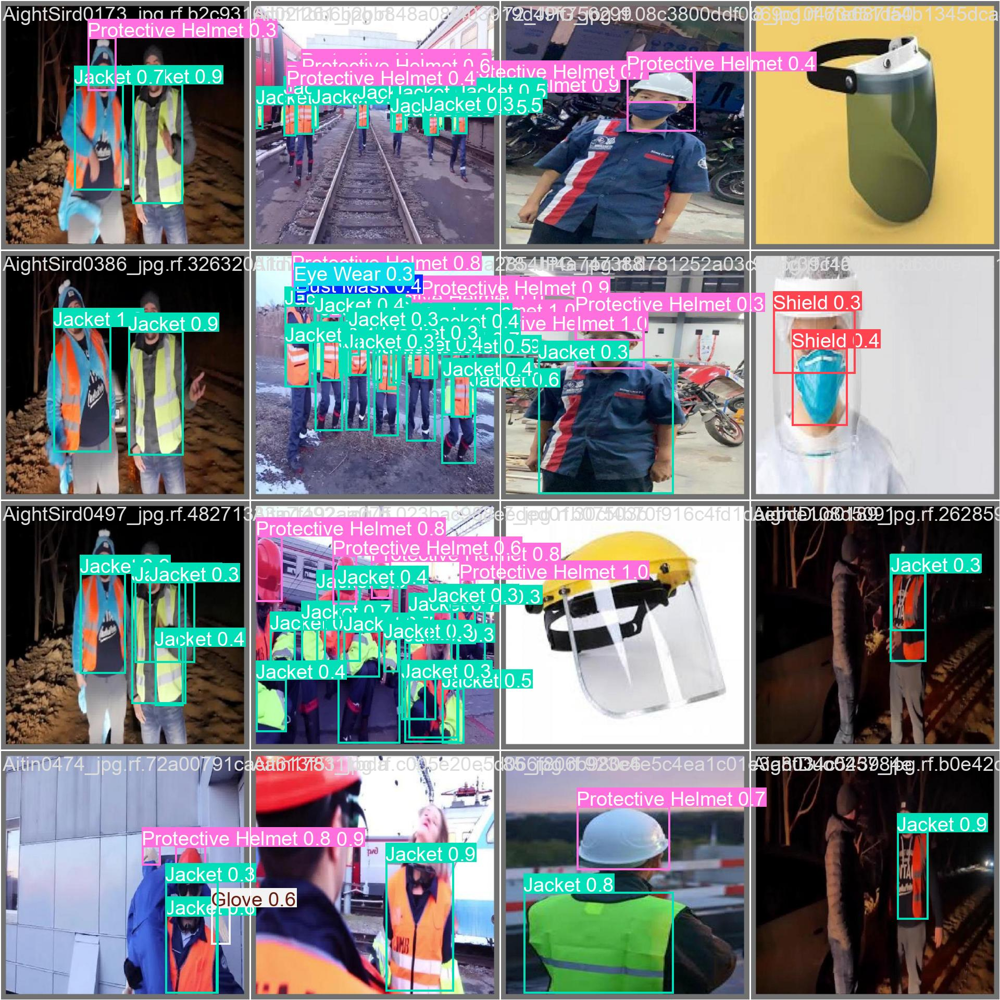

In [31]:
Image("/content/runs/detect/custom_yolo11n/val_batch1_pred.jpg", width=600)

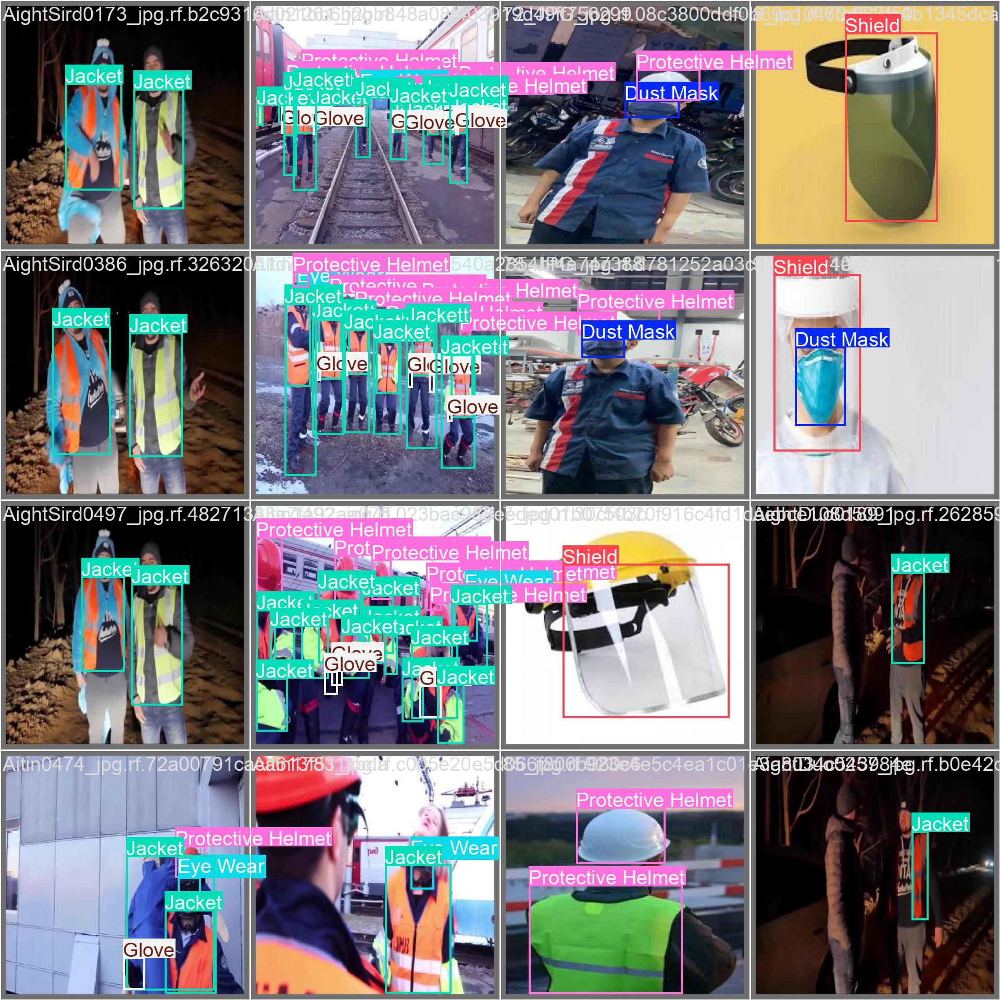

In [32]:
Image("/content/runs/detect/custom_yolo11n/val_batch1_labels.jpg", width=600)

### Step # 07 Validate Fine-Tuned Model

In [33]:
!yolo task=detect mode=val model="/content/runs/detect/custom_yolo11n/weights/best.pt" data={dataset.location}/data.yaml

Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,007,013 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /content/PPE_Detection-1/valid/labels.cache... 649 images, 0 backgrounds, 0 corrupt: 100% 649/649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 41/41 [00:08<00:00,  4.56it/s]
                   all        649       3126      0.759      0.728      0.775      0.495
             Dust Mask        301        311      0.918       0.81      0.888      0.547
              Eye Wear        148        149      0.525      0.586      0.581      0.303
                 Glove        354        644      0.872      0.857      0.886      0.576
                Jacket        364        607      0.687      0.837      0.846        0.6
      Protective Boots        299        610        0.9      0.949      0.967      0.627
     Protective Helmet        413        780    

### Step # 08 Inference with Custom Model on Images


In [34]:
!yolo task=detect mode=predict model="/content/runs/detect/custom_yolo11n/weights/best.pt" conf=0.25 source={dataset.location}/test/images save=True

Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,007,013 parameters, 0 gradients, 8.1 GFLOPs

image 1/325 /content/PPE_Detection-1/test/images/000446_jpg.rf.5ea7ca6bde68eb546e8c3dcd1c0fd6d5.jpg: 640x640 1 Dust Mask, 1 Glove, 2 Protective Helmets, 8.9ms
image 2/325 /content/PPE_Detection-1/test/images/20220721_161946_jpg.rf.4ff1543edb0405f57fb590d5dcb284b6.jpg: 640x640 1 Glove, 7.4ms
image 3/325 /content/PPE_Detection-1/test/images/20220721_162015_jpg.rf.ee54ba7d79baa065a7cfc4666f0fd024.jpg: 640x640 1 Glove, 3 Protective Helmets, 7.4ms
image 4/325 /content/PPE_Detection-1/test/images/20220721_162036_jpg.rf.9d32aa23505a54eff5555d9b667bb597.jpg: 640x640 1 Glove, 7.3ms
image 5/325 /content/PPE_Detection-1/test/images/20220721_162308_jpg.rf.2f8d1ad4716998b9fc123d94dce4d8b0.jpg: 640x640 1 Protective Helmet, 7.3ms
image 6/325 /content/PPE_Detection-1/test/images/20220721_162435_jpg.rf.f36f898409158c65a23c0604535ff366.jpg: 6

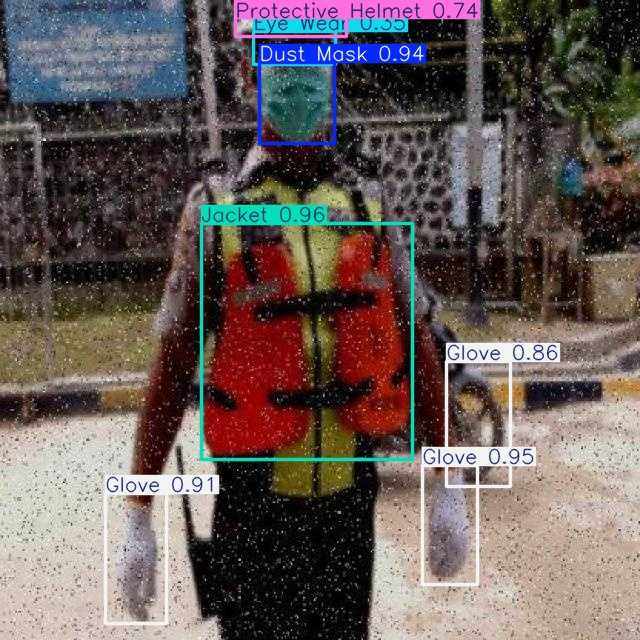

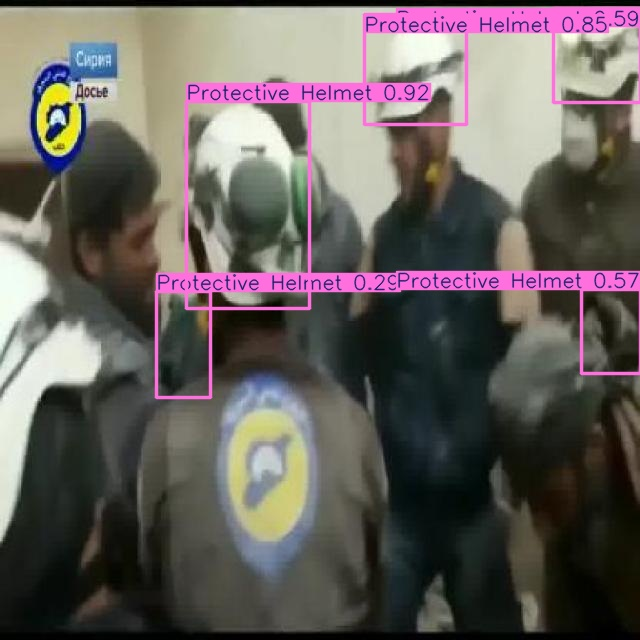

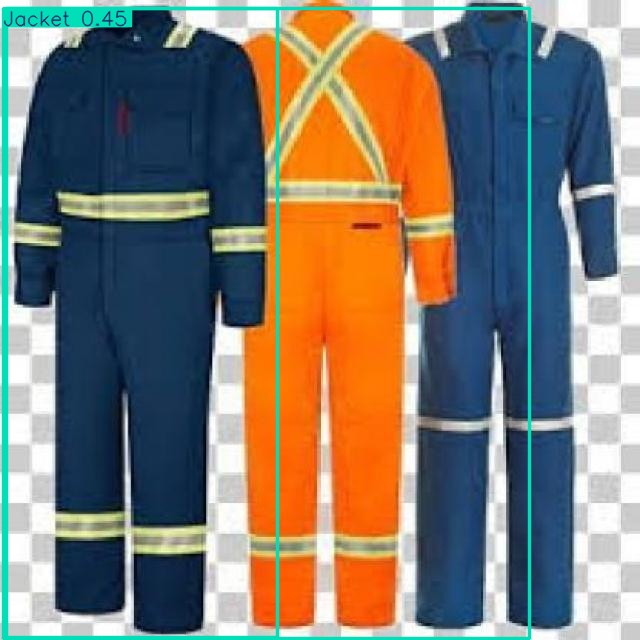

In [35]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob('/content/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[1:4]:
    display(IPyImage(filename=img, width=600))
    print("\n")

In [36]:
!gdown "https://drive.google.com/uc?id=1ACZp9gmtjEdIY-SHp8K0xdR0D8Gjd3j3&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1ACZp9gmtjEdIY-SHp8K0xdR0D8Gjd3j3&confirm=t
To: /content/image2.jpg
100% 77.7k/77.7k [00:00<00:00, 3.15MB/s]


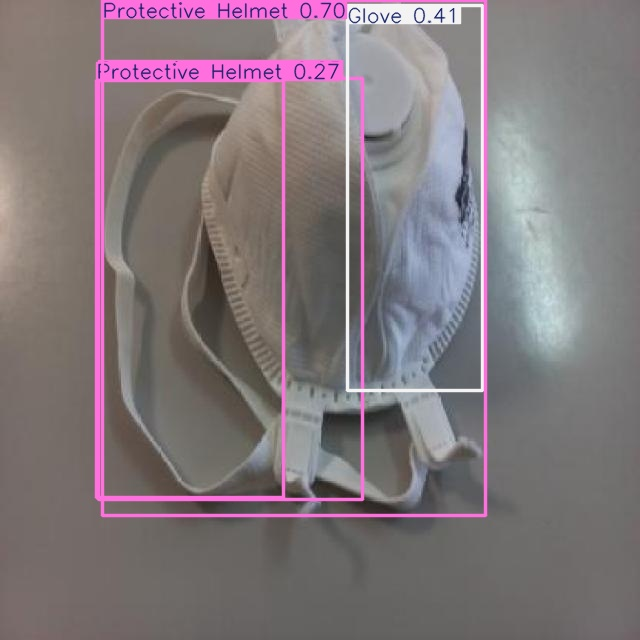

In [38]:
Image("/content/runs/detect/predict/20220721_162015_jpg.rf.ee54ba7d79baa065a7cfc4666f0fd024.jpg", width=600)

### Step # 09 Inference with Custom Model on Videos

In [39]:
!gdown "https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t
To: /content/PPE_Part1.mp4
100% 14.2M/14.2M [00:00<00:00, 39.8MB/s]


In [40]:
!gdown "https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t
To: /content/PPE_Part2.mp4
100% 11.1M/11.1M [00:00<00:00, 43.9MB/s]


In [42]:
!yolo task=detect mode=predict model= "/content/runs/detect/custom_yolo11n/weights/best.pt" conf=0.25 source="PPE_Part1.mp4" save=True

Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,007,013 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/310) /content/PPE_Part1.mp4: 384x640 3 Jackets, 34.8ms
video 1/1 (frame 2/310) /content/PPE_Part1.mp4: 384x640 3 Jackets, 1 Protective Helmet, 8.7ms
video 1/1 (frame 3/310) /content/PPE_Part1.mp4: 384x640 4 Jackets, 1 Protective Helmet, 8.0ms
video 1/1 (frame 4/310) /content/PPE_Part1.mp4: 384x640 4 Jackets, 1 Protective Helmet, 8.7ms
video 1/1 (frame 5/310) /content/PPE_Part1.mp4: 384x640 4 Jackets, 1 Protective Helmet, 9.5ms
video 1/1 (frame 6/310) /content/PPE_Part1.mp4: 384x640 3 Jackets, 3 Protective Helmets, 8.0ms
video 1/1 (frame 7/310) /content/PPE_Part1.mp4: 384x640 3 Jackets, 1 Protective Helmet, 14.9ms
video 1/1 (frame 8/310) /content/PPE_Part1.mp4: 384x640 4 Jackets, 1 Protective Boots, 1 Protective Helmet, 11.1ms
video 1/1 (frame 9/310) /content/PPE_Part1.mp4: 384x640 5 Jackets, 1 Protective B

In [49]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict3/PPE_Part1.avi'

# Compressed video path
compressed_path = "/content/PPE_Part1.mp4"

# Compress the video using ffmpeg
os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
with open(compressed_path, 'rb') as mp4_file:
    mp4 = mp4_file.read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(HTML(f"""
        <video width="640" height="480" controls>
            <source src="{data_url}" type="video/mp4">
        </video>
    """))
